# **Information Retrieval**
## **Assignment-3**

## **Dependencies**

In [ ]:
!pip install numpy==1.21.5
!pip install pandas==1.3.5
!pip install matplotlib==3.2.2

     |████████████████████████████████| 15.7 MB 21.4 MB/s 
  Attempting uninstall: numpy
    Found existing installation: numpy 1.21.6
    Uninstalling numpy-1.21.6:
      Successfully uninstalled numpy-1.21.6
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.8.0 requires tf-estimator-nightly==2.8.0.dev2021122109, which is not installed.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


## **Imports**

In [ ]:
import numpy as np
print("Numpy:\t",np.__version__)
import pandas as pd 
print("Pandas:\t",pd.__version__)
import matplotlib.pyplot as plt
import matplotlib
print("Matplotlib:\t",matplotlib.__version__)

Numpy:	 1.21.6
Pandas:	 1.3.5
Matplotlib:	 3.2.2


## **Question 1**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [12]:
with open('/content/drive/MyDrive/Wiki-Vote.txt','r') as f:
  data = [list(map(int,num.split(" "))) for num in [x.replace(('\t'), ' ').strip() for x in f.readlines()][4:]]
data

[[30, 1412],
 [30, 3352],
 [30, 5254],
 [30, 5543],
 [30, 7478],
 [3, 28],
 [3, 30],
 [3, 39],
 [3, 54],
 [3, 108],
 [3, 152],
 [3, 178],
 [3, 182],
 [3, 214],
 [3, 271],
 [3, 286],
 [3, 300],
 [3, 348],
 [3, 349],
 [3, 371],
 [3, 567],
 [3, 581],
 [3, 584],
 [3, 586],
 [3, 590],
 [3, 604],
 [3, 611],
 [3, 8283],
 [25, 3],
 [25, 6],
 [25, 8],
 [25, 19],
 [25, 23],
 [25, 28],
 [25, 29],
 [25, 30],
 [25, 33],
 [25, 35],
 [25, 50],
 [25, 54],
 [25, 55],
 [25, 75],
 [25, 80],
 [25, 86],
 [25, 94],
 [25, 127],
 [25, 152],
 [25, 154],
 [25, 182],
 [25, 192],
 [25, 214],
 [25, 224],
 [25, 226],
 [25, 246],
 [25, 252],
 [25, 255],
 [25, 257],
 [25, 261],
 [25, 271],
 [25, 273],
 [25, 280],
 [25, 282],
 [25, 286],
 [25, 299],
 [25, 300],
 [25, 302],
 [25, 306],
 [25, 308],
 [25, 310],
 [25, 322],
 [25, 325],
 [25, 339],
 [25, 348],
 [25, 349],
 [25, 356],
 [25, 358],
 [25, 363],
 [25, 370],
 [25, 371],
 [25, 373],
 [25, 377],
 [25, 379],
 [25, 407],
 [25, 415],
 [25, 422],
 [25, 428],
 [25, 439

Convert 2d Array to 1D

In [ ]:
data_np = []
for item in data:
  data_np.append(item[0])
  data_np.append(item[1])
len(data_np)

207378

Get Unique Nodes in the Dataset

In [13]:
minimum_node_number = min(list(set(data_np)))
maximum_node_number = max(list(set(data_np)))
print("Minimum Node No.: ",minimum_node_number)
print("Maximum Node No.: ",maximum_node_number)

Minimum Node No.:  3
Maximum Node No.:  8297


In [14]:
nodes = list(set(data_np))
print("Number of Unique Nodes:\t",len(nodes))

Number of Unique Nodes:	 7115


As each entry in the dataset represents an directed edge, the number of edges = No. of unique entries in dataset

In [15]:
print("Number of Unique Edges:\t",len(data))

Number of Unique Edges:	 103689


### **Adjacency Matrix**



*   Each entry in a row of ith node represents an outgoing edge.
*   Each entry in a column of ith node represents an incoming edge.
*   0 represents no edge
*   1 represents an directed edge



In [16]:
adjacency_matrix_np = []
for i in range(maximum_node_number+1):
  adjacency_matrix_np.append([0 for i in range(maximum_node_number+1)])

In [17]:
for src_edge, dest_edge in data:
  # Add the edge to the adjancy matrix
  adjacency_matrix_np[src_edge][dest_edge]=1
adjacency_matrix_np

[[0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,


#### **Calculate In-degrees**

In [18]:
adjacency_matrix_df = adjacency_matrix_np.copy()
in_degrees = dict.fromkeys(list(range(maximum_node_number+1)))
for j in range(maximum_node_number+1):
  summation = 0
  for i in range(maximum_node_number+1):
    summation += adjacency_matrix_df[i][j]
  in_degrees[j]=summation
in_degrees

{0: 0,
 1: 0,
 2: 0,
 3: 31,
 4: 0,
 5: 0,
 6: 20,
 7: 0,
 8: 44,
 9: 0,
 10: 15,
 11: 0,
 12: 0,
 13: 0,
 14: 0,
 15: 361,
 16: 0,
 17: 0,
 18: 0,
 19: 22,
 20: 0,
 21: 0,
 22: 0,
 23: 22,
 24: 0,
 25: 0,
 26: 0,
 27: 0,
 28: 122,
 29: 41,
 30: 23,
 31: 0,
 32: 14,
 33: 34,
 34: 20,
 35: 110,
 36: 34,
 37: 0,
 38: 14,
 39: 28,
 40: 0,
 41: 0,
 42: 0,
 43: 0,
 44: 0,
 45: 0,
 46: 0,
 47: 0,
 48: 0,
 49: 22,
 50: 32,
 51: 0,
 52: 0,
 53: 0,
 54: 40,
 55: 67,
 56: 149,
 57: 0,
 58: 0,
 59: 0,
 60: 0,
 61: 20,
 62: 0,
 63: 0,
 64: 9,
 65: 0,
 66: 0,
 67: 0,
 68: 0,
 69: 0,
 70: 0,
 71: 0,
 72: 154,
 73: 0,
 74: 0,
 75: 69,
 76: 0,
 77: 0,
 78: 0,
 79: 0,
 80: 43,
 81: 0,
 82: 0,
 83: 0,
 84: 0,
 85: 0,
 86: 108,
 87: 0,
 88: 0,
 89: 16,
 90: 0,
 91: 0,
 92: 0,
 93: 17,
 94: 27,
 95: 39,
 96: 0,
 97: 0,
 98: 0,
 99: 0,
 100: 0,
 101: 0,
 102: 0,
 103: 0,
 104: 0,
 105: 21,
 106: 0,
 107: 0,
 108: 11,
 109: 0,
 110: 0,
 111: 0,
 112: 0,
 113: 0,
 114: 0,
 115: 0,
 116: 0,
 117: 0,
 118: 0,


#### **Calculate Out-degrees**

In [19]:
out_degrees = dict.fromkeys(list(range(maximum_node_number+1)))
for i in range(maximum_node_number+1):
  summation = 0
  for j in range(maximum_node_number+1):
    summation += adjacency_matrix_df[i][j]
  out_degrees[i]=summation
out_degrees

{0: 0,
 1: 0,
 2: 0,
 3: 23,
 4: 29,
 5: 23,
 6: 302,
 7: 24,
 8: 182,
 9: 81,
 10: 86,
 11: 743,
 12: 65,
 13: 11,
 14: 114,
 15: 50,
 16: 15,
 17: 45,
 18: 12,
 19: 39,
 20: 187,
 21: 76,
 22: 2,
 23: 74,
 24: 309,
 25: 90,
 26: 95,
 27: 102,
 28: 133,
 29: 150,
 30: 5,
 31: 15,
 32: 4,
 33: 24,
 34: 5,
 35: 65,
 36: 227,
 37: 20,
 38: 14,
 39: 41,
 40: 11,
 41: 30,
 42: 89,
 43: 4,
 44: 44,
 45: 8,
 46: 59,
 47: 146,
 48: 21,
 49: 15,
 50: 14,
 51: 24,
 52: 1,
 53: 39,
 54: 7,
 55: 64,
 56: 24,
 57: 13,
 58: 38,
 59: 94,
 60: 9,
 61: 0,
 62: 17,
 63: 1,
 64: 1,
 65: 2,
 66: 44,
 67: 17,
 68: 275,
 69: 0,
 70: 0,
 71: 109,
 72: 164,
 73: 13,
 74: 69,
 75: 31,
 76: 2,
 77: 25,
 78: 41,
 79: 53,
 80: 59,
 81: 18,
 82: 1,
 83: 8,
 84: 1,
 85: 1,
 86: 122,
 87: 195,
 88: 1,
 89: 29,
 90: 72,
 91: 2,
 92: 5,
 93: 1,
 94: 80,
 95: 2,
 96: 2,
 97: 0,
 98: 8,
 99: 24,
 100: 5,
 101: 16,
 102: 5,
 103: 68,
 104: 30,
 105: 3,
 106: 9,
 107: 4,
 108: 2,
 109: 190,
 110: 95,
 111: 29,
 112: 1,
 

### **Adjacency List**

In [20]:
adjacency_list = dict.fromkeys(np.unique(data_np),[])
for src_edge, dest_edge in data:
  adjacency_list[src_edge]=[]

for src_edge, dest_edge in data:
  # Add the edge to the adjancy list
  adjacency_list[src_edge].append(dest_edge)
adjacency_list

{3: [28,
  30,
  39,
  54,
  108,
  152,
  178,
  182,
  214,
  271,
  286,
  300,
  348,
  349,
  371,
  567,
  581,
  584,
  586,
  590,
  604,
  611,
  8283],
 4: [8,
  10,
  28,
  30,
  38,
  55,
  56,
  75,
  130,
  140,
  147,
  151,
  152,
  214,
  232,
  243,
  282,
  299,
  341,
  363,
  370,
  415,
  560,
  606,
  611,
  645,
  650,
  659,
  8282],
 5: [6,
  8,
  10,
  23,
  30,
  33,
  38,
  50,
  54,
  55,
  61,
  75,
  89,
  93,
  127,
  130,
  147,
  153,
  163,
  167,
  168,
  175,
  299],
 6: [3,
  8,
  10,
  19,
  23,
  28,
  29,
  30,
  33,
  34,
  35,
  38,
  39,
  50,
  54,
  55,
  56,
  61,
  80,
  86,
  89,
  93,
  94,
  127,
  130,
  132,
  135,
  140,
  147,
  151,
  153,
  154,
  163,
  167,
  168,
  171,
  175,
  178,
  182,
  183,
  216,
  219,
  226,
  227,
  228,
  232,
  236,
  243,
  250,
  252,
  257,
  258,
  259,
  261,
  271,
  273,
  274,
  280,
  285,
  286,
  290,
  298,
  299,
  300,
  301,
  304,
  306,
  317,
  319,
  322,
  325,
  339,
  348,
 

In [22]:
# Reverse Adjacency list for In-Degree
rev_adjacency_list = dict.fromkeys(np.unique(data_np),[])
for src_edge, dest_edge in data:
  rev_adjacency_list[dest_edge]=[]

for src_edge, dest_edge in data:
  # Add the edge to the adjancy list
  rev_adjacency_list[dest_edge].append(src_edge)

#### **Average In-Degree**

In [23]:
in_degrees_list  = []
for neighbours in rev_adjacency_list.values():
  in_degrees_list.append(len(neighbours))
print("Average In-Degree:\t",(sum(in_degrees_list)/len(in_degrees_list)))

Average In-Degree:	 14.573295853829936


#### **Average Out-Degree**

In [24]:
out_degrees_list  = []
for neighbours in adjacency_list.values():
  out_degrees_list.append(len(neighbours))
print("Average Out-Degree:\t",(sum(out_degrees_list)/len(out_degrees_list)))

Average Out-Degree:	 14.573295853829936


#### **Node with Max In-degree**

In [25]:
print("Node with Max In-degree:\t",max(in_degrees, key=in_degrees.get))
print("Max In-degree:\t",max(in_degrees.values()))

Node with Max In-degree:	 4037
Max In-degree:	 457


#### **Node with Max out-degree**

In [26]:
print("Node with Max out-degree:\t",max(out_degrees, key=out_degrees.get))
print("Max Out-degree:\t",max(out_degrees.values()))

Node with Max out-degree:	 2565
Max Out-degree:	 893


#### **The density of the network**
[Reference for formulae](http://users.cecs.anu.edu.au/~xlx/teaching/css2013/network-density.html#:~:text=The%20Density%20of%20a%20network,of%20edges%20in%20the%20graph.) 
<br> <br>

**Density of the network (directed) = (Num of Edges)/(Num of Nodes * (Num of Nodes-1))**

In [27]:
numerator = len(data)
denominator = len(nodes)*(len(nodes)-1)
print("Density of the network:\t",numerator/denominator)

Density of the network:	 0.0020485375110809584


### **Degree Distribution of the Network**
The degree of a node in a network is the number of connections it has to other nodes and the degree distribution is the probability distribution of these degrees over the whole network.
<br> [Reference](https://en.wikipedia.org/wiki/Degree_distribution#:~:text=In%20the%20study%20of%20graphs,degrees%20over%20the%20whole%20network.)

**In-Degree Distribution of the Network**

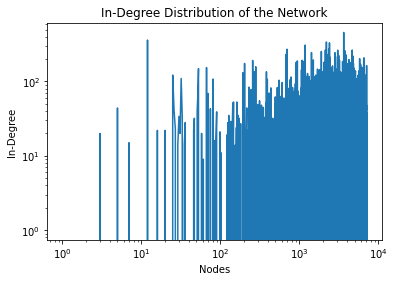

In [28]:
plt.loglog(range(len(in_degrees_list)), in_degrees_list) 
plt.title('In-Degree Distribution of the Network')
plt.xlabel('Nodes')
plt.ylabel('In-Degree')
plt.show()

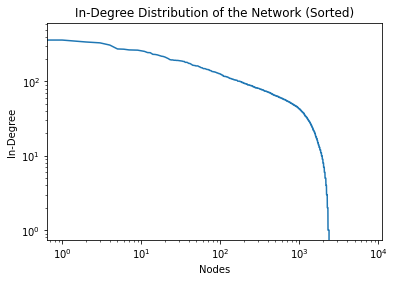

In [29]:
in_degrees_list.sort(reverse=True)
plt.loglog(range(len(in_degrees_list)), in_degrees_list) 
plt.title('In-Degree Distribution of the Network (Sorted)')
plt.xlabel('Nodes')
plt.ylabel('In-Degree')
plt.show()

**Out-Degree Distribution of the Network**

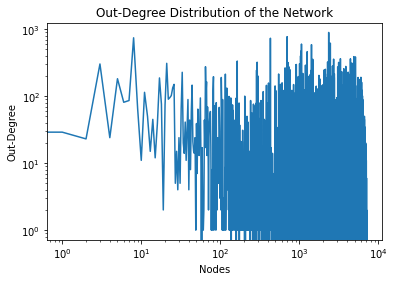

In [30]:
plt.loglog(range(len(out_degrees_list)), out_degrees_list) 
plt.title('Out-Degree Distribution of the Network')
plt.xlabel('Nodes')
plt.ylabel('Out-Degree')
plt.show()

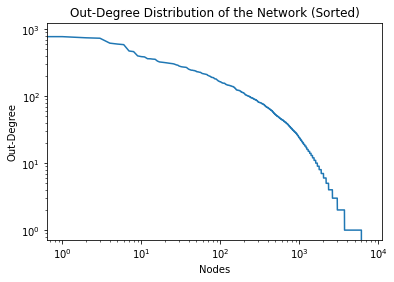

In [31]:
out_degrees_list.sort(reverse=True)
plt.loglog(range(len(out_degrees_list)), out_degrees_list) 
plt.title('Out-Degree Distribution of the Network (Sorted)')
plt.xlabel('Nodes')
plt.ylabel('Out-Degree')
plt.show()

### **Clustering-Coefficient Distribution**
In graph theory, a clustering coefficient is a measure of the degree to which nodes in a graph tend to cluster together. <br>
Two versions of this measure exist: the global and the local. The global version was designed to give an overall indication of the clustering in the network, whereas the local gives an indication of the embeddedness of single nodes. <br>
[Reference](https://www.geeksforgeeks.org/clustering-coefficient-graph-theory/)

In [32]:
# TODO: Add formula as an image or text

clustering_coefficients = {} # Key: node ; Value: Clusterin_Coefficient

for primary_node,neighbours_primary_node in adjacency_list.items():
  i=0
  degree_primary_node = len(neighbours_primary_node)
  count=0
  if degree_primary_node>1:
    # i.e, greater or equal to 2, so that denomintor never becomes 0. for eg.if degree==1 then (1*(1-1))=(1*0)=0
    while i<len(neighbours_primary_node):
      # for each neighbour node y of ith node x, find if the node y has a neighbour who is also a neighbour of x
      j=0
      while j<len(neighbours_primary_node):
        if i!=j and neighbours_primary_node[i] in adjacency_list[neighbours_primary_node[j]]:
          count+=1
        j+=1
      neighbours_secondary_node = adjacency_list[neighbours_primary_node[i]]
      common_neighbours = list(set(neighbours_secondary_node).intersection(set(neighbours_primary_node)))
      numerator = len(common_neighbours)
      numerator = count
      denominator = degree_primary_node*(degree_primary_node-1)
      clustering_coefficient_node = numerator/denominator
      clustering_coefficients[primary_node]=clustering_coefficient_node
      i+=1
  else:
    clustering_coefficients[primary_node]=0
clustering_coefficients

{3: 0.07509881422924901,
 4: 0.13669950738916256,
 5: 0.191699604743083,
 6: 0.030659391432531737,
 7: 0.09239130434782608,
 8: 0.04319713435735535,
 9: 0.05416666666666667,
 10: 0.06757865937072503,
 11: 0.02612160941473519,
 12: 0.051201923076923075,
 13: 0.11818181818181818,
 14: 0.030740568234746156,
 15: 0.06693877551020408,
 16: 0.11904761904761904,
 17: 0.08787878787878788,
 18: 0.12878787878787878,
 19: 0.1106612685560054,
 20: 0.03306307860387557,
 21: 0.030526315789473683,
 22: 0.0,
 23: 0.05368382080710848,
 24: 0.04190308073803219,
 25: 0.10074906367041199,
 26: 0.060582306830907054,
 27: 0.03805086390992041,
 28: 0.05639097744360902,
 29: 0.03923937360178971,
 30: 0.05,
 31: 0.05238095238095238,
 32: 0.0,
 33: 0.09239130434782608,
 34: 0.45,
 35: 0.03461538461538462,
 36: 0.049471755487115514,
 37: 0.06842105263157895,
 38: 0.1043956043956044,
 39: 0.13048780487804879,
 40: 0.09090909090909091,
 41: 0.07241379310344828,
 42: 0.03677221654749745,
 43: 0.08333333333333333,
 

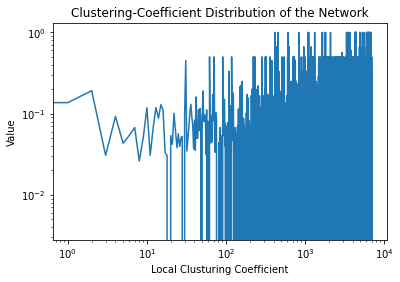

In [33]:
plt.loglog(range(len(list(clustering_coefficients.values()))), list(clustering_coefficients.values())) 
plt.title('Clustering-Coefficient Distribution of the Network')
plt.xlabel('Local Clusturing Coefficient')
plt.ylabel('Value')
plt.show()

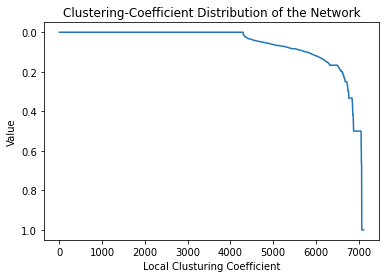

In [34]:
clustering_coefficients_sorted = list(clustering_coefficients.values())
clustering_coefficients_sorted.sort()
plt.plot(range(len(clustering_coefficients_sorted)), clustering_coefficients_sorted) 
plt.title('Clustering-Coefficient Distribution of the Network')
plt.xlabel('Local Clusturing Coefficient')
plt.ylabel('Value')
plt.gca().invert_yaxis()
plt.show()

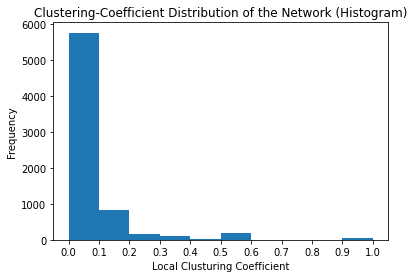

In [35]:
plt.hist(clustering_coefficients.values(),bins=[0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1.0])
plt.xticks([0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1.0])
plt.title("Clustering-Coefficient Distribution of the Network (Histogram)")
plt.xlabel('Local Clusturing Coefficient')
plt.ylabel('Frequency')
plt.show()